In [ ]:
#  Copyright (c) Microsoft Corporation.
#  Licensed under the MIT License.

# Introduction
Though users can automatically run the whole Quant research worklfow based on configurations with Qlib.

Some advanced users usally would like to carefully customize each component to explore more in Quant.

If you just want a simple example of Qlib. [Quick start](https://github.com/microsoft/qlib#quick-start) and [workflow_by_code](https://github.com/microsoft/qlib/blob/main/examples/workflow_by_code.ipynb) may be a better choice for you.

If you want to know more details about Quant research, this notebook may be a better place for you to start.

We hope this script could be a tutorial for users who are interested in the details of Quant.

This notebook tries to demonstrate how can we use Qlib to build components step by step. 

In [2]:
from pprint import pprint
from pathlib import Path
import pandas as pd

In [3]:
MARKET = "csi300"
BENCHMARK = "SH000300"
EXP_NAME = "tutorial_exp"

# Data

## Get data

Users can follow [the steps](https://github.com/microsoft/qlib/tree/main/scripts#download-qlib-data) to download data with CLI.

In this example we use the underlying API to automatically download data

In [4]:
from qlib.tests.data import GetData
GetData().qlib_data(exists_skip=True)

2022-11-03 08:55:45.259 | WARNING  | qlib.tests.data:qlib_data:150 - Data already exists: ~/.qlib/qlib_data/cn_data, the data download will be skipped
	If downloading is required: `exists_skip=False` or `change target_dir`


In [5]:
import qlib
qlib.init()

[12706:MainThread](2022-11-03 08:56:06,552) INFO - qlib.Initialization - [config.py:413] - default_conf: client.
[12706:MainThread](2022-11-03 08:56:07,079) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[12706:MainThread](2022-11-03 08:56:07,079) INFO - qlib.Initialization - [__init__.py:74] - qlib successfully initialized based on client settings.
[12706:MainThread](2022-11-03 08:56:07,080) INFO - qlib.Initialization - [__init__.py:76] - data_path={'__DEFAULT_FREQ': PosixPath('/Users/zhanglijun/.qlib/qlib_data/cn_data')}


## Inspect raw data

Currently, Qlib support several kinds of data source.

### Calendar

In [6]:
from qlib.data import D
D.calendar(start_time='2010-01-01', end_time='2017-12-31', freq='day')[:2]  # calendar data

array([Timestamp('2010-01-04 00:00:00'), Timestamp('2010-01-05 00:00:00')],
      dtype=object)

### Basic data

In [7]:
df = D.features(['SH601216'], ['$open', '$high', '$low', '$close', '$factor'], start_time='2020-05-01', end_time='2020-05-31')   

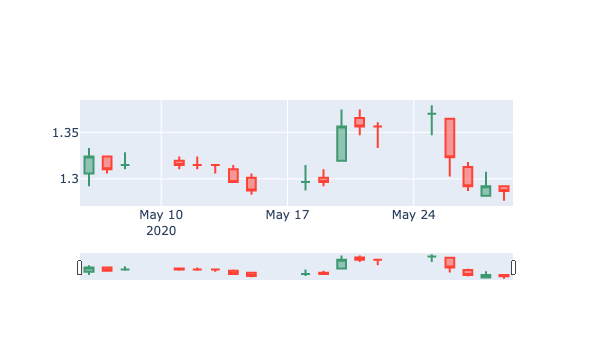

In [8]:
import plotly.graph_objects as go
fig = go.Figure(data=[go.Candlestick(x=df.index.get_level_values("datetime"),
                open=df['$open'],
                high=df['$high'],
                low=df['$low'],
                close=df['$close'])])
fig.show()

### price adjustment

Maybe you think the price is not what it looks like in real world.

Due to the price adjustment, the price will be different from the real trading data .

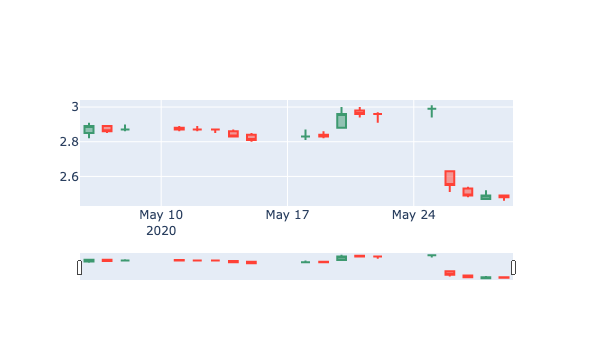

In [9]:
import plotly.graph_objects as go
fig = go.Figure(data=[go.Candlestick(x=df.index.get_level_values("datetime"),
                open=df['$open'] / df['$factor'],
                high=df['$high'] / df['$factor'],
                low=df['$low'] / df['$factor'],
                close=df['$close'] / df['$factor'])])
fig.show()

Please notice the price gap on [2020-05-26](http://vip.stock.finance.sina.com.cn/corp/view/vISSUE_ShareBonusDetail.php?stockid=601216&type=1&end_date=2020-05-20)

If we want to represent the change of assets value by price, adjust prices are necesary.
By default, Qlib stores the adjusted prices.

### Static universe V.S. dynamic universe

Dynamic universe

In [11]:
# dynamic universe
universe = D.list_instruments(D.instruments('csi100'),  start_time='2010-01-01', end_time='2020-12-31')
#pprint(universe)

In [12]:
print(len(universe))

212


Qlib use dynamic universe by default.

csi100 has around 100 stocks each day(it is not that accurate due to the low precision of data).

[22078:MainThread](2022-11-03 08:59:35,359) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[22080:MainThread](2022-11-03 08:59:35,702) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[22077:MainThread](2022-11-03 08:59:36,316) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[22079:MainThread](2022-11-03 08:59:36,925) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[22076:MainThread](2022-11-03 08:59:37,649) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[22075:MainThread](2022-11-03 08:59:38,247) INFO - qlib.workflow 

<AxesSubplot:xlabel='datetime'>

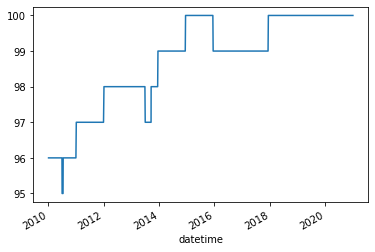

In [13]:
df = D.features(D.instruments('csi100'), ['$close'], start_time='2010-01-01', end_time='2020-12-31')   
df.groupby('datetime').size().plot()

### Point-In-Time data

#### download data
NOTE: To run the test faster, we only download the data of two stocks

In [14]:
p = Path("~/.qlib/qlib_data/cn_data/financial").expanduser()

In [15]:
if not p.exists():
    !cd ../../scripts/data_collector/pit/ && pip install -r requirements.txt
    !cd ../../scripts/data_collector/pit/ && python collector.py download_data --source_dir ~/.qlib/stock_data/source/pit --start 2000-01-01 --end 2020-01-01 --interval quarterly --symbol_regex "^(600519|000725).*"
    !cd ../../scripts/data_collector/pit/ && python collector.py normalize_data --interval quarterly --source_dir ~/.qlib/stock_data/source/pit --normalize_dir ~/.qlib/stock_data/source/pit_normalized
    !cd ../../scripts/ && python dump_pit.py dump --csv_path ~/.qlib/stock_data/source/pit_normalized --qlib_dir ~/.qlib/qlib_data/cn_data --interval quarterly
    pass

     |████████████████████████████████| 55 kB 139 kB/s eta 0:00:01
     |████████████████████████████████| 46 kB 132 kB/s eta 0:00:01
login success!
2022-11-03 09:00:21.006 | INFO     | collector:get_instrument_list:82 - get cn stock symbols......
2022-11-03 09:00:33.532 | INFO     | collector:get_instrument_list:87 - get 2 symbols.
2022-11-03 09:00:33.532 | INFO     | data_collector.base:collector_data:204 - start collector data......
2022-11-03 09:00:33.532 | INFO     | data_collector.base:collector_data:209 - getting data: 1
100%|█████████████████████████████████████████████| 2/2 [00:38<00:00, 19.32s/it]
[]
2022-11-03 09:01:12.173 | INFO     | data_collector.base:_collector:197 - error symbol nums: 0
2022-11-03 09:01:12.173 | INFO     | data_collector.base:_collector:198 - current get symbol nums: 2
2022-11-03 09:01:12.173 | INFO     | data_collector.base:collector_data:211 - 1 finish.
2022-11-03 09:01:12.173 | INFO     | data_collector.base:collector_data:218 - total 2, error: 0
lo

#### querying data
using `roewa(performanceExpressROEWa,业绩快报净资产收益率ROE-加权)` as an example

If we want to get fundamental data `in the most recent quarter` daily, we can use following example.

Maitai release part of its fundamental data on [2019-07-13](http://www.cninfo.com.cn/new/disclosure/detail?stockCode=600519&announcementId=1206443183&orgId=gssh0600519&announcementTime=2019-07-13) and  release others on [2019-07-18](http://www.cninfo.com.cn/new/disclosure/detail?stockCode=600519&announcementId=1206456129&orgId=gssh0600519&announcementTime=2019-07-18)

In [16]:
instruments = ["sh600519"]
data = D.features(instruments, ['P($$roewa_q)'], start_time="2019-01-01", end_time="2019-07-19", freq="day")

In [17]:
data.tail(15)

P($$roewa_q)
instrument datetime                
sh600519   2019-07-01      0.094737
           2019-07-02      0.094737
           2019-07-03      0.094737
           2019-07-04      0.094737
           2019-07-05      0.094737
           2019-07-08      0.094737
           2019-07-09      0.094737
           2019-07-10      0.094737
           2019-07-11      0.094737
           2019-07-12      0.094737
           2019-07-15      0.000000
           2019-07-16      0.000000
           2019-07-17      0.000000
           2019-07-18      0.175322
           2019-07-19      0.175322

### experss engine


In [18]:
D.features(["sh600519"], ['(EMA($close, 12) - EMA($close, 26))/$close - EMA((EMA($close, 12) - EMA($close, 26))/$close, 9)/$close'])

(EMA($close, 12) - EMA($close, 26))/$close - EMA((EMA($close, 12) - EMA($close, 26))/$close, 9)/$close
instrument datetime                                                                                                          
sh600519   2005-01-04                                           0.000000                                                     
           2005-01-05                                           0.000217                                                     
           2005-01-06                                          -0.000111                                                     
           2005-01-07                                          -0.000001                                                     
           2005-01-10                                           0.001045                                                     
...                                                                  ...                                                     
           2021-06-07                                           0.026083                                                     
           2021-06-08                                           0.024713                                                     
           2021-06-09                                           0.022833                                                     
           2021-06-10                                           0.022195                                                     
           2021-06-11                                           0.020165                                                     

[3995 rows x 1 columns]


## Dataset loading and preprocessing 

Some heuristic principles of create features
- make the features comparable between instrumets: remove unit from the features.
- try to keep the distribution invariant
- keep the scale of features similar

### data loader

It's interface can be found [here](https://github.com/microsoft/qlib/blob/main/qlib/data/dataset/loader.py#L24) 

QlibDataLoader is an implementation which load data from Qlib's data source

In [19]:
from qlib.data.dataset.loader import QlibDataLoader

In [20]:
qdl = QlibDataLoader(config=(['$close / Ref($close, 10)'], ['RET10']))

In [21]:
qdl.load(instruments=['sh600519'], start_time='20190101', end_time='20191231')

,,RET10
datetime,instrument,
2019-01-02,sh600519,1.014326
2019-01-03,sh600519,0.998409
2019-01-04,sh600519,1.041883
2019-01-07,sh600519,1.053943
2019-01-08,sh600519,1.065878
...,...,...
2019-12-25,sh600519,0.978188
2019-12-26,sh600519,0.998329
2019-12-27,sh600519,1.000000


### data handler

finance data can't be perfect.

We have to process them before feeding them into Models

In [22]:
df = qdl.load(instruments=['sh600519'], start_time='20190101', end_time='20191231')

In [23]:
df.isna().sum()

RET10    4
dtype: int64

<AxesSubplot:ylabel='Frequency'>

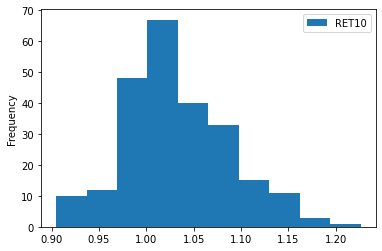

In [24]:
df.plot(kind='hist')

Datahander is responsible for data preprocessing and provides data fetching interface 



In [25]:
from qlib.data.dataset.handler import DataHandlerLP
from qlib.data.dataset.processor import ZScoreNorm, Fillna

In [26]:
# NOTE: normally, the training & validation time range will be  `fit_start_time` ， `fit_end_time`
# however，all the components are decomposed, so the training & validation time range is unknown when preprocessing.
dh = DataHandlerLP(instruments=['sh600519'], start_time='20170101', end_time='20191231',
             infer_processors=[ZScoreNorm(fit_start_time='20170101', fit_end_time='20181231'), Fillna()],
             data_loader=qdl)

[12706:MainThread](2022-11-03 09:20:53,312) INFO - qlib.timer - [log.py:117] - Time cost: 0.007s | Loading data Done
[12706:MainThread](2022-11-03 09:20:53,322) INFO - qlib.timer - [log.py:117] - Time cost: 0.008s | ZScoreNorm Done
[12706:MainThread](2022-11-03 09:20:53,323) INFO - qlib.timer - [log.py:117] - Time cost: 0.000s | Fillna Done
[12706:MainThread](2022-11-03 09:20:53,323) INFO - qlib.timer - [log.py:117] - Time cost: 0.011s | fit & process data Done
[12706:MainThread](2022-11-03 09:20:53,324) INFO - qlib.timer - [log.py:117] - Time cost: 0.020s | Init data Done


In [27]:
df = dh.fetch()

In [28]:
df

,,RET10
datetime,instrument,
2017-01-03,sh600519,0.208830
2017-01-04,sh600519,1.105991
2017-01-05,sh600519,0.707463
2017-01-06,sh600519,1.118294
2017-01-09,sh600519,1.299336
...,...,...
2019-12-25,sh600519,-0.630645
2019-12-26,sh600519,-0.279826
2019-12-27,sh600519,-0.250719


In [29]:
df.isna().sum()

RET10    0
dtype: int64

<AxesSubplot:ylabel='Frequency'>

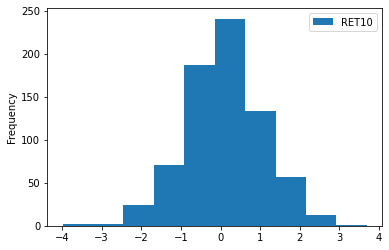

In [30]:
df.plot(kind='hist')

### dataset

#### basic dataset

In [31]:
from qlib.data.dataset import DatasetH, TSDatasetH

In [32]:
ds = DatasetH(dh, segments={"train": ('20180101', '20181231'), "valid": ('20190101', '20191231')})

In [33]:
ds.prepare('train')

,,RET10
datetime,instrument,
2018-01-02,sh600519,0.745533
2018-01-03,sh600519,1.022683
2018-01-04,sh600519,1.075763
2018-01-05,sh600519,1.195880
2018-01-08,sh600519,1.514490
...,...,...
2018-12-24,sh600519,-0.529236
2018-12-25,sh600519,-0.764602
2018-12-26,sh600519,-1.105943


In [34]:
ds.prepare('valid')

,,RET10
datetime,instrument,
2019-01-02,sh600519,-0.001186
2019-01-03,sh600519,-0.278426
2019-01-04,sh600519,0.478797
2019-01-07,sh600519,0.688852
2019-01-08,sh600519,0.896746
...,...,...
2019-12-25,sh600519,-0.630645
2019-12-26,sh600519,-0.279826
2019-12-27,sh600519,-0.250719


#### Time Series Dataset

For different model, the required dataset format will be different.

For example, Qlib provides a Time Series Dataset(TSDatasetH) to help users to create time-series dataset.

In [35]:
ds = TSDatasetH(step_len=10, handler=dh, segments={"train": ('20180101', '20181231'), "valid": ('20190101', '20191231')})
train_sampler = ds.prepare('train')

In [36]:
train_sampler

In [37]:
train_sampler[0] # Retrieving the first example

array([[ 0.68848056],
       [ 1.4185926 ],
       [ 1.5865678 ],
       [ 1.294261  ],
       [ 0.74273646],
       [ 0.537918  ],
       [-0.3557673 ],
       [ 1.1682972 ],
       [ 0.9135168 ],
       [ 0.74553335]], dtype=float32)

In [38]:
train_sampler['2018-01-08', 'sh600519']  # get the time series by <'timestamp', 'instrument_id'> index

array([[ 0.74273646],
       [ 0.537918  ],
       [-0.3557673 ],
       [ 1.1682972 ],
       [ 0.9135168 ],
       [ 0.74553335],
       [ 1.0226825 ],
       [ 1.0757632 ],
       [ 1.1958798 ],
       [ 1.5144904 ]], dtype=float32)

### Off-the-shelf dataset

Qlib integrated some dataset alreadly

In [39]:
handler_kwargs = {
        "start_time": "2008-01-01",
        "end_time": "2020-08-01",
        "fit_start_time": "2008-01-01",
        "fit_end_time": "2014-12-31",
        "instruments": MARKET,
}
handler_conf = {
    "class": "Alpha158",
    "module_path": "qlib.contrib.data.handler",
    "kwargs": handler_kwargs,
}
pprint(handler_conf)

{'class': 'Alpha158',
 'kwargs': {'end_time': '2020-08-01',
            'fit_end_time': '2014-12-31',
            'fit_start_time': '2008-01-01',
            'instruments': 'csi300',
            'start_time': '2008-01-01'},
 'module_path': 'qlib.contrib.data.handler'}


In [40]:
from qlib.utils import init_instance_by_config

In [70]:
hd = init_instance_by_config(handler_conf);

[75136:MainThread](2022-11-03 10:18:36,668) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[75131:MainThread](2022-11-03 10:18:37,337) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[75134:MainThread](2022-11-03 10:18:37,980) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[75132:MainThread](2022-11-03 10:18:38,646) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[75135:MainThread](2022-11-03 10:18:39,424) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[75133:MainThread](2022-11-03 10:18:40,488) INFO - qlib.workflow 

Using config to create instance is a highly frequently used practice in Qlib (e.g. the [workflows configurations](https://github.com/microsoft/qlib/blob/main/examples/benchmarks/LightGBM/workflow_config_lightgbm_Alpha158.yaml) are based on it).


The above configuration is the same as the code below

In [69]:
from qlib.contrib.data.handler import Alpha158
hd = Alpha158(**handler_kwargs);

[73829:MainThread](2022-11-03 10:16:46,111) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[73828:MainThread](2022-11-03 10:16:46,459) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[73825:MainThread](2022-11-03 10:16:47,198) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[73830:MainThread](2022-11-03 10:16:47,872) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[73827:MainThread](2022-11-03 10:16:48,764) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[73826:MainThread](2022-11-03 10:16:49,769) INFO - qlib.workflow 

This dataset has the same structure as the simple one with 1 column  we created just now.

In [43]:
df = hd.fetch()

In [44]:
df

KMID      KLEN     KMID2       KUP      KUP2  \
datetime   instrument                                                     
2008-01-02 SH600000    0.010377  0.061132  0.169754  0.028302  0.462962   
           SH600004    0.057279  0.059666  0.960000  0.002387  0.040000   
           SH600006    0.012673  0.040323  0.314285  0.008065  0.200000   
           SH600007    0.066977  0.084186  0.795579  0.007907  0.093923   
           SH600008    0.051163  0.082326  0.621469  0.027907  0.338984   
...                         ...       ...       ...       ...       ...   
2020-07-31 SZ300413    0.011740  0.040868  0.287273  0.018874  0.461818   
           SZ300433    0.030103  0.048604  0.619354  0.014111  0.290324   
           SZ300498   -0.003356  0.023490 -0.142858  0.012164  0.517855   
           SZ300601    0.008080  0.067009  0.120586  0.013750  0.205197   
           SZ300628   -0.013750  0.040312 -0.341085  0.017187  0.426356   

                           KLOW     KLOW2      KSFT     KSFT2     OPEN0  ...  \
datetime   instrument                                                    ...   
2008-01-02 SH600000    0.022453  0.367285  0.004528  0.074077  0.989729  ...   
           SH600004    0.000000  0.000000  0.054893  0.920001  0.945824  ...   
           SH600006    0.019585  0.485715  0.024194  0.600000  0.987486  ...   
           SH600007    0.009302  0.110498  0.068372  0.812153  0.937228  ...   
           SH600008    0.003256  0.039547  0.026512  0.322033  0.951327  ...   
...                         ...       ...       ...       ...       ...  ...   
2020-07-31 SZ300413    0.010254  0.250909  0.003121  0.076364  0.988396  ...   
           SZ300433    0.004390  0.090322  0.020382  0.419352  0.970776  ...   
           SZ300498    0.007970  0.339287 -0.007550 -0.321425  1.003367  ...   
           SZ300601    0.045179  0.674217  0.039509  0.589605  0.991984  ...   
           SZ300628    0.009375  0.232558 -0.021562 -0.534883  1.013942  ...   

                        VSUMN10   VSUMN20   VSUMN30   VSUMN60    VSUMD5  \
datetime   instrument                                                     
2008-01-02 SH600000    0.550639  0.490807  0.485962  0.510337 -0.022349   
           SH600004    0.328894  0.392360  0.423984  0.514932  0.633267   
           SH600006    0.522838  0.433405  0.494553  0.524930 -0.064064   
           SH600007    0.242611  0.291541  0.352613  0.420448  0.878055   
           SH600008    0.425714  0.381852  0.400486  0.469882  0.482783   
...                         ...       ...       ...       ...       ...   
2020-07-31 SZ300413    0.559005  0.514765  0.531086  0.492531 -0.424739   
           SZ300433    0.508023  0.507246  0.467712  0.490444  0.000004   
           SZ300498    0.565064  0.523422  0.489674  0.491646 -0.545229   
           SZ300601    0.265613  0.387342  0.425360  0.465201  0.537872   
           SZ300628    0.510992  0.482686  0.511605  0.508130 -0.074103   

                        VSUMD10   VSUMD20   VSUMD30   VSUMD60    LABEL0  
datetime   instrument                                                    
2008-01-02 SH600000   -0.101278  0.018386  0.028076 -0.020675  0.042068  
           SH600004    0.342211  0.215280  0.152031 -0.029863  0.000000  
           SH600006   -0.045677  0.133190  0.010894 -0.049861 -0.008830  
           SH600007    0.514779  0.416918  0.294774  0.159104  0.007496  
           SH600008    0.148572  0.236296  0.199027  0.060235 -0.015445  
...                         ...       ...       ...       ...       ...  
2020-07-31 SZ300413   -0.118010 -0.029530 -0.062173  0.014938 -0.037566  
           SZ300433   -0.016046 -0.014492  0.064577  0.019113 -0.031677  
           SZ300498   -0.130127 -0.046844  0.020651  0.016708 -0.006531  
           SZ300601    0.468775  0.225316  0.149280  0.069599  0.090264  
           SZ300628   -0.021985  0.034628 -0.023210 -0.016260  0.004142  

[909996 rows x 159 columns]

In [45]:
hd.data_loader

In [68]:
hd.data_loader.fields;

#### some details

The training data may not be the same as the test data.

e.g.
- the training dataset and test dataset use a different fitlering rules,  data processing

In [47]:
hd.learn_processors

In [48]:
hd.infer_processors

[]

In [49]:
hd.process_type # appending type

'append'

In [50]:
hd.fetch(col_set="label", data_key=hd.DK_L)

LABEL0
datetime   instrument          
2008-01-02 SH600000    1.226919
           SH600004   -0.362926
           SH600006   -0.696644
           SH600007   -0.079643
           SH600008   -0.946646
...                         ...
2020-07-31 SZ300413   -1.478743
           SZ300433   -1.244404
           SZ300498   -0.243809
           SZ300601    3.607769
           SZ300628    0.180854

[874151 rows x 1 columns]

In [51]:
hd.fetch(col_set="label", data_key=hd.DK_I)

LABEL0
datetime   instrument          
2008-01-02 SH600000    0.042068
           SH600004    0.000000
           SH600006   -0.008830
           SH600007    0.007496
           SH600008   -0.015445
...                         ...
2020-07-31 SZ300413   -0.037566
           SZ300433   -0.031677
           SZ300498   -0.006531
           SZ300601    0.090264
           SZ300628    0.004142

[909996 rows x 1 columns]

In [52]:
dataset_conf = {
        "class": "DatasetH",
        "module_path": "qlib.data.dataset",
        "kwargs": {
            "handler": hd,
            "segments": {
                "train": ("2008-01-01", "2014-12-31"),
                "valid": ("2015-01-01", "2016-12-31"),
                "test": ("2017-01-01", "2020-08-01"),
            },
        },
}

In [53]:
dataset = init_instance_by_config(dataset_conf)

# Model Training & Inference

[Model interface](https://github.com/microsoft/qlib/blob/main/qlib/model/base.py)

In [54]:
from qlib.workflow import R
from qlib.workflow.record_temp import SignalRecord, PortAnaRecord, SigAnaRecord

In [55]:
model = init_instance_by_config({
        "class": "LGBModel",
        "module_path": "qlib.contrib.model.gbdt",
        "kwargs": {
            "loss": "mse",
            "colsample_bytree": 0.8879,
            "learning_rate": 0.0421,
            "subsample": 0.8789,
            "lambda_l1": 205.6999,
            "lambda_l2": 580.9768,
            "max_depth": 8,
            "num_leaves": 210,
            "num_threads": 20,
        },
})

ModuleNotFoundError.  PyTorch models are skipped (optional: maybe installing pytorch can fix it).


In [56]:
# start exp to train model
with R.start(experiment_name=EXP_NAME):
    model.fit(dataset)
    R.save_objects(trained_model=model)

    rec = R.get_recorder()
    rid = rec.id # save the record id

    # Inference and saving signal
    sr = SignalRecord(model, dataset, rec)
    sr.generate()

[12706:MainThread](2022-11-03 09:28:00,730) INFO - qlib.workflow - [expm.py:316] - <mlflow.tracking.client.MlflowClient object at 0x7fe4d9420370>
[12706:MainThread](2022-11-03 09:28:00,753) WARNING - qlib.workflow - [expm.py:196] - No valid experiment found. Create a new experiment with name tutorial_exp.
[12706:MainThread](2022-11-03 09:28:00,757) INFO - qlib.workflow - [exp.py:260] - Experiment 1 starts running ...
[12706:MainThread](2022-11-03 09:28:00,869) INFO - qlib.workflow - [recorder.py:339] - Recorder 189101fc5eb44593a261dd8248593078 starts running under Experiment 1 ...


Training until validation scores don't improve for 50 rounds
[20]	train's l2: 0.99032	valid's l2: 0.99407
[40]	train's l2: 0.98654	valid's l2: 0.993434
[60]	train's l2: 0.983952	valid's l2: 0.993192
[80]	train's l2: 0.981825	valid's l2: 0.993024
[100]	train's l2: 0.97992	valid's l2: 0.992874
[120]	train's l2: 0.978043	valid's l2: 0.992838
[140]	train's l2: 0.976317	valid's l2: 0.992838
[160]	train's l2: 0.974702	valid's l2: 0.992849
[180]	train's l2: 0.97313	valid's l2: 0.992885
[200]	train's l2: 0.971546	valid's l2: 0.992959
Early stopping, best iteration is:
[168]	train's l2: 0.974048	valid's l2: 0.992791


[12706:MainThread](2022-11-03 09:28:36,540) INFO - qlib.workflow - [record_temp.py:194] - Signal record 'pred.pkl' has been saved as the artifact of the Experiment 1
[12706:MainThread](2022-11-03 09:28:36,644) INFO - qlib.timer - [log.py:117] - Time cost: 0.000s | waiting `async_log` Done


'The following are prediction results of the LGBModel model.'
                          score
datetime   instrument          
2017-01-03 SH600000   -0.036180
           SH600008    0.012532
           SH600009    0.036990
           SH600010   -0.020218
           SH600015   -0.129913


# Evaluation:
- Signal-based
- Portfolio-based: backtest 

In [57]:
###################################
# prediction, backtest & analysis
###################################
port_analysis_config = {
    "executor": {
        "class": "SimulatorExecutor",
        "module_path": "qlib.backtest.executor",
        "kwargs": {
            "time_per_step": "day",
            "generate_portfolio_metrics": True,
        },
    },
    "strategy": {
        "class": "TopkDropoutStrategy",
        "module_path": "qlib.contrib.strategy.signal_strategy",
        "kwargs": {
            "signal": "<PRED>",
            "topk": 50,
            "n_drop": 5,
        },
    },
    "backtest": {
        "start_time": "2017-01-01",
        "end_time": "2020-08-01",
        "account": 100000000,
        "benchmark": BENCHMARK,
        "exchange_kwargs": {
            "freq": "day",
            "limit_threshold": 0.095,
            "deal_price": "close",
            "open_cost": 0.0005,
            "close_cost": 0.0015,
            "min_cost": 5,
        },
    },
}

# backtest and analysis
with R.start(experiment_name=EXP_NAME, recorder_id=rid, resume=True):

    # signal-based analysis
    rec = R.get_recorder()
    sar = SigAnaRecord(rec)
    sar.generate()
    
    #  portfolio-based analysis: backtest
    par = PortAnaRecord(rec, port_analysis_config, "day")
    par.generate()

[12706:MainThread](2022-11-03 09:31:47,131) INFO - qlib.workflow - [expm.py:316] - <mlflow.tracking.client.MlflowClient object at 0x7fe3c654c5e0>
[12706:MainThread](2022-11-03 09:31:47,135) INFO - qlib.workflow - [exp.py:260] - Experiment 1 starts running ...
[12706:MainThread](2022-11-03 09:31:47,148) INFO - qlib.workflow - [recorder.py:339] - Recorder 189101fc5eb44593a261dd8248593078 starts running under Experiment 1 ...
[12706:MainThread](2022-11-03 09:31:48,527) INFO - qlib.backtest caller - [__init__.py:94] - Create new exchange


{'IC': 0.05148803789130272,
 'ICIR': 0.42031572420936425,
 'Rank IC': 0.05356545680294088,
 'Rank ICIR': 0.4463186746626947}


[43744:MainThread](2022-11-03 09:31:50,998) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[43742:MainThread](2022-11-03 09:31:51,596) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[43751:MainThread](2022-11-03 09:31:52,242) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[43745:MainThread](2022-11-03 09:31:52,916) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[43753:MainThread](2022-11-03 09:31:53,653) INFO - qlib.workflow - [expm.py:31] - experiment manager uri is at file:/Users/zhanglijun/Documents/StockProject/qlib/examples/tutorial/mlruns
[43747:MainThread](2022-11-03 09:31:54,652) INFO - qlib.workflow 

backtest loop:   0%|          | 0/871 [00:00<?, ?it/s]

/Users/zhanglijun/opt/anaconda3/lib/python3.9/site-packages/qlib/utils/index_data.py:482: RuntimeWarning:

Mean of empty slice

[12706:MainThread](2022-11-03 09:32:24,438) INFO - qlib.workflow - [record_temp.py:499] - Portfolio analysis record 'port_analysis_1day.pkl' has been saved as the artifact of the Experiment 1
[12706:MainThread](2022-11-03 09:32:24,453) INFO - qlib.workflow - [record_temp.py:524] - Indicator analysis record 'indicator_analysis_1day.pkl' has been saved as the artifact of the Experiment 1
[12706:MainThread](2022-11-03 09:32:24,469) INFO - qlib.timer - [log.py:117] - Time cost: 0.008s | waiting `async_log` Done


'The following are analysis results of benchmark return(1day).'
                       risk
mean               0.000477
std                0.012295
annualized_return  0.113561
information_ratio  0.598699
max_drawdown      -0.370479
'The following are analysis results of the excess return without cost(1day).'
                       risk
mean               0.000687
std                0.005483
annualized_return  0.163574
information_ratio  1.933691
max_drawdown      -0.097084
'The following are analysis results of the excess return with cost(1day).'
                       risk
mean               0.000492
std                0.005482
annualized_return  0.117084
information_ratio  1.384504
max_drawdown      -0.105894
'The following are analysis results of indicators(1day).'
     value
ffr    1.0
pa     0.0
pos    0.0


# Loading results & Analysis

## loading data
Because Qlib leverage MLflow to save model & data.
All the data can be access by `mlflow ui`

In [58]:
# load recorder
recorder = R.get_recorder(recorder_id=rid, experiment_name=EXP_NAME)

In [59]:
# load previous results
pred_df = recorder.load_object("pred.pkl")
report_normal_df = recorder.load_object("portfolio_analysis/report_normal_1day.pkl")
positions = recorder.load_object("portfolio_analysis/positions_normal_1day.pkl")
analysis_df = recorder.load_object("portfolio_analysis/port_analysis_1day.pkl")

In [60]:
# Previous Model can be loaded. but it is not used.
loaded_model = recorder.load_object("trained_model")
loaded_model

In [61]:
from qlib.contrib.report import analysis_model, analysis_position

## analysis position

### report

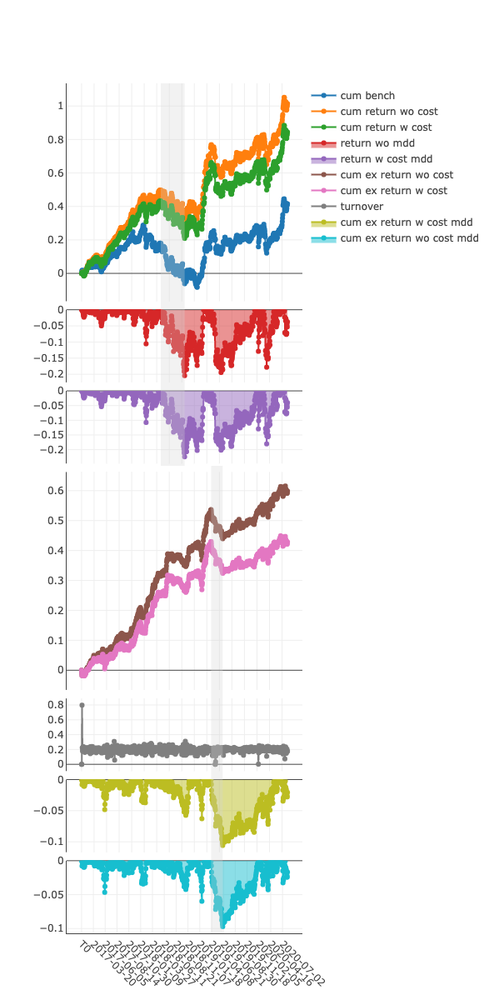

In [62]:
analysis_position.report_graph(report_normal_df)

### risk analysis

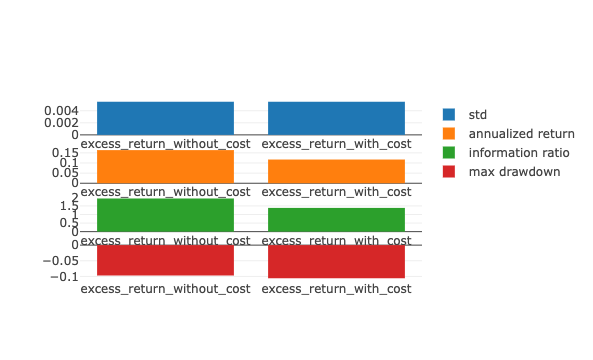

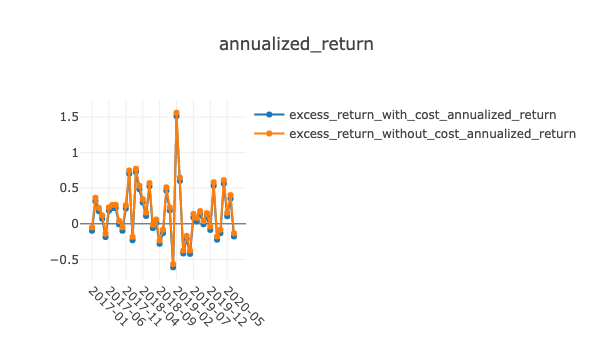

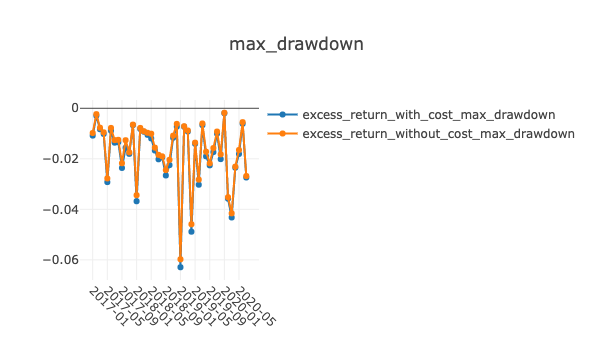

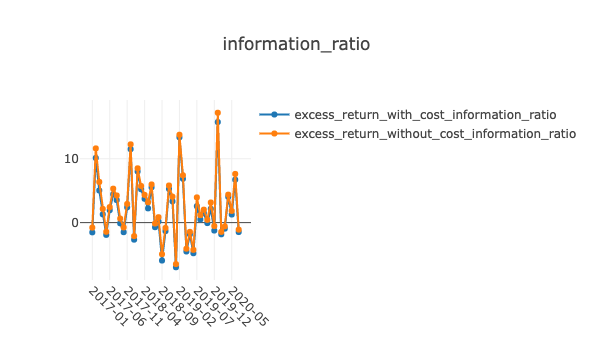

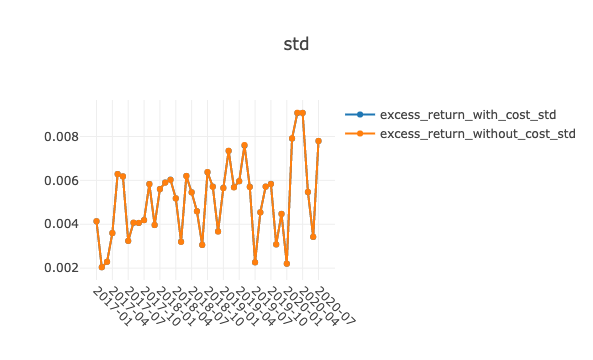

In [63]:
analysis_position.risk_analysis_graph(analysis_df, report_normal_df)

## analysis model

In [65]:
label_df = dataset.prepare("test", col_set="label")
label_df.columns = ['label']

### score IC

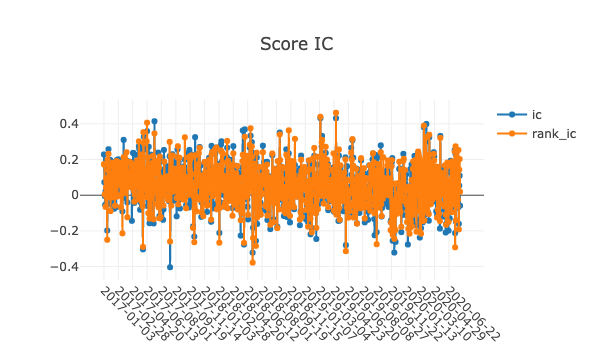

In [66]:
pred_label = pd.concat([label_df, pred_df], axis=1, sort=True).reindex(label_df.index)
analysis_position.score_ic_graph(pred_label)

### model performance

/Users/zhanglijun/opt/anaconda3/lib/python3.9/site-packages/statsmodels/graphics/gofplots.py:993: UserWarning:

marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.



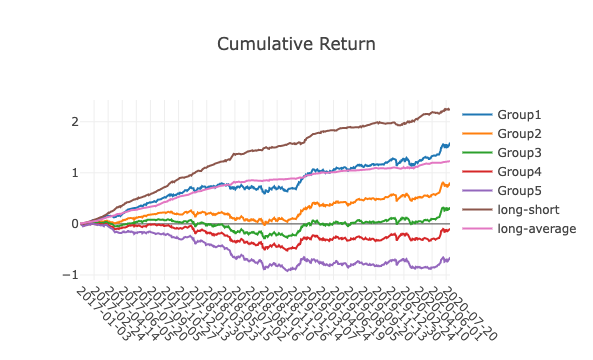

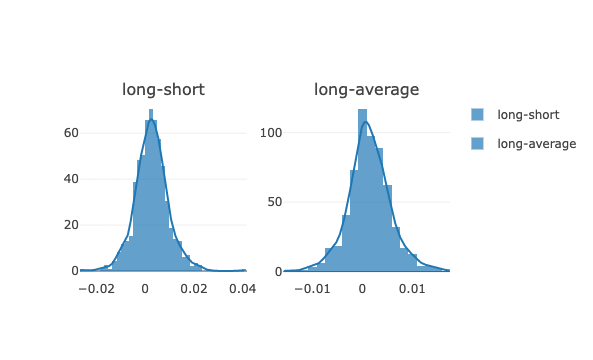

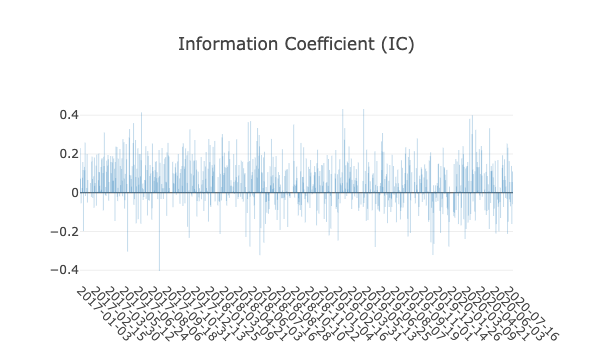

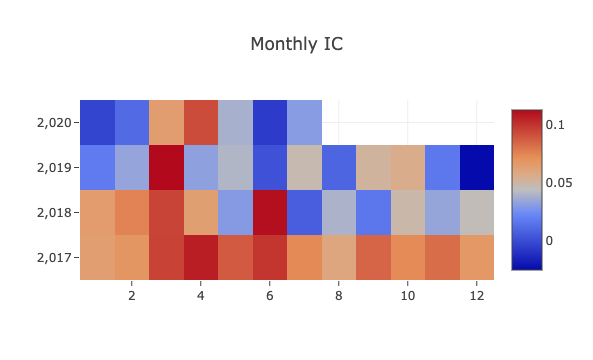

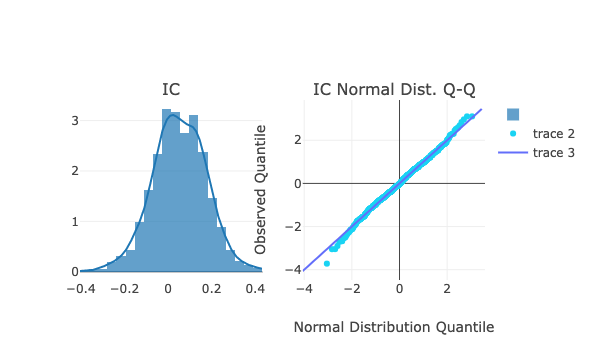

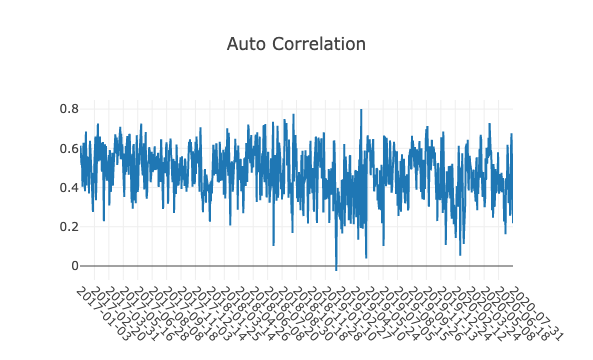

In [67]:
analysis_model.model_performance_graph(pred_label)